<a href="https://colab.research.google.com/github/piyahub/MINOR_PROJECT/blob/main/step_by_step_WGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:

from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [2]:
## !!!!!!!!!!!!!!!! upload croppedHEALTHY.zip to you google drive first

!unzip /content/drive/MyDrive/croppedHEALTHY.zip -d non-faulty

Archive:  /content/drive/MyDrive/croppedHEALTHY.zip
   creating: non-faulty/croppedHEALTHY/
  inflating: non-faulty/croppedHEALTHY/Screenshot 2024-12-02 161843.png  
  inflating: non-faulty/croppedHEALTHY/Screenshot 2024-12-02 161849.png  
  inflating: non-faulty/croppedHEALTHY/Screenshot 2024-12-02 161858.png  
  inflating: non-faulty/croppedHEALTHY/Screenshot 2024-12-02 161902.png  
  inflating: non-faulty/croppedHEALTHY/Screenshot 2024-12-02 161907.png  
  inflating: non-faulty/croppedHEALTHY/Screenshot 2025-03-05 111012.png  
  inflating: non-faulty/croppedHEALTHY/Screenshot 2025-03-05 111022.png  
  inflating: non-faulty/croppedHEALTHY/Screenshot 2025-03-05 111026.png  
  inflating: non-faulty/croppedHEALTHY/Screenshot 2025-03-05 111030.png  
  inflating: non-faulty/croppedHEALTHY/Screenshot 2025-03-05 111034.png  
  inflating: non-faulty/croppedHEALTHY/Screenshot 2025-03-05 111039.png  
  inflating: non-faulty/croppedHEALTHY/Screenshot 2025-03-05 111044.png  
  inflating: non-fau

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import os

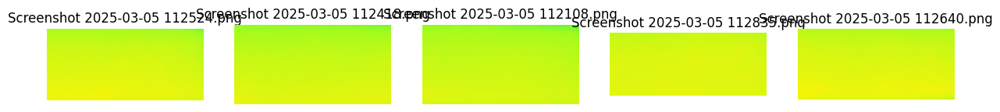

In [5]:
## !!!!!!!!!!!!!!!!!!!!! Change the croppedHEALTHY file name to "non faulty"

import os
import random
import matplotlib.pyplot as plt
from PIL import Image

folder_path = "/content/non-faulty/croppedHEALTHY"

image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

sample_images = random.sample(image_files, 5)

fig, axes = plt.subplots(1, 5, figsize=(15, 5))
for i, image_file in enumerate(sample_images):
    image_path = os.path.join(folder_path, image_file)
    try:
        img = Image.open(image_path)
        axes[i].imshow(img)
        axes[i].set_title(image_file)
        axes[i].axis('off')
    except Exception as e:
        print(f"Error loading image {image_file}: {e}")
plt.show()

In [6]:

# Define image dimensions and data split ratios
img_width, img_height = 128, 128
train_ratio = 0.6
validation_ratio = 0.2
test_ratio = 0.2

# Create an ImageDataGenerator for data augmentation and preprocessing
datagen = ImageDataGenerator(
    rescale=1./255,  # Normalize pixel values
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    validation_split=validation_ratio + test_ratio  # Train/val split
)

# Create train generator (with grayscale conversion)
train_generator = datagen.flow_from_directory(
    '/content/non-faulty/',
    target_size=(img_width, img_height),
    color_mode='grayscale',  # Convert images to grayscale
    batch_size=32,
    class_mode='categorical',  # or 'binary' if binary classification
    subset='training',
    shuffle=True
)

# Create validation generator (with grayscale conversion)
validation_generator = datagen.flow_from_directory(
    '/content/non-faulty/',
    target_size=(img_width, img_height),
    color_mode='grayscale',  # Convert images to grayscale
    batch_size=32,
    class_mode='categorical',
    subset='validation',
    shuffle=False
)


Found 323 images belonging to 1 classes.
Found 215 images belonging to 1 classes.


In [7]:
latent_dim = 100
critic_updates = 1
lambda_gp = 50

In [8]:
def self_attention(x, filters):
    """
    Self-attention mechanism to refine feature maps.
    """
    f = layers.Conv2D(filters // 8, kernel_size=1, padding='same')(x)  # Query
    g = layers.Conv2D(filters // 8, kernel_size=1, padding='same')(x)  # Key
    h = layers.Conv2D(filters, kernel_size=1, padding='same')(x)       # Value

    # Reshape for matrix multiplication
    f = layers.Reshape((-1, filters // 8))(f)  # Shape: (batch, height*width, filters//8)
    g = layers.Reshape((-1, filters // 8))(g)
    h = layers.Reshape((-1, filters))(h)       # Shape: (batch, height*width, filters)

    # Compute attention map
    attention = layers.Softmax()(layers.Dot(axes=[2, 2])([f, g]))  # (batch, height*width, height*width)

    # Apply attention to value
    o = layers.Dot(axes=[1, 1])([attention, h])  # (batch, height*width, filters)

    # Reshape back to (height, width, filters)
    o = layers.Reshape((x.shape[1], x.shape[2], filters))(o)

    # Skip connection
    o = layers.Add()([x, o])

    return o


In [9]:
def build_generator():
    input_layer = keras.Input(shape=(latent_dim,))

    x = layers.Dense(16 * 16 * 512, activation='relu')(input_layer)
    x = layers.Reshape((16, 16, 512))(x)

    x = layers.Conv2DTranspose(256, (4,4), strides=(2,2), padding='same')(x)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = self_attention(x, 256)

    x = layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same')(x)
    x = layers.LeakyReLU(alpha=0.2)(x)

    # Add another self-attention at 64x64 resolution
    x = self_attention(x, 128)

    x = layers.Conv2DTranspose(64, (4,4), strides=(2,2), padding='same')(x)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = layers.Conv2DTranspose(64, (4,4), strides=(2,2), padding='same')(x)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = layers.Conv2DTranspose(1, (4,4), strides=(2,2), padding='same', activation='tanh')(x)

    # Ensure final output is exactly 256x256
    x = layers.Resizing(256, 256)(x)

    return keras.Model(input_layer, x)


generator = build_generator()

noise = np.random.randn(1, 100)
generated_images = generator.predict(noise)
print("Generated Image Shape:", generated_images.shape)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
Generated Image Shape: (1, 256, 256, 1)


In [10]:
def build_critic():
    model = keras.Sequential([
        keras.Input(shape=(256, 256, 1)),  # Explicit input layer
        layers.Conv2D(64, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(negative_slope=0.2),
        layers.Conv2D(128, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(negative_slope=0.2),
        layers.Conv2D(256, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(negative_slope=0.2),
        layers.Flatten(),
        layers.Dense(1)  # No activation, since it's a critic
    ])
    return model


critic = build_critic()

In [12]:
critic_optimizer = keras.optimizers.Adam(learning_rate=0.00001, beta_1=0.5, beta_2=0.9)
generator_optimizer = keras.optimizers.Adam(learning_rate=0.00005, beta_1=0.5, beta_2=0.9)

Found 538 images belonging to 1 classes.
Epoch 0: Critic Loss=42.84424591064453, Generator Loss=-5.240794052951969e-05
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


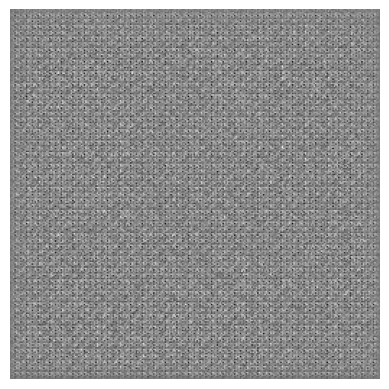

Epoch 5: Critic Loss=42.33567428588867, Generator Loss=-0.0007659478578716516
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


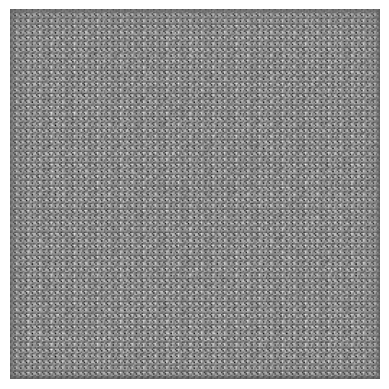

Epoch 10: Critic Loss=41.83817672729492, Generator Loss=-0.005278442986309528
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


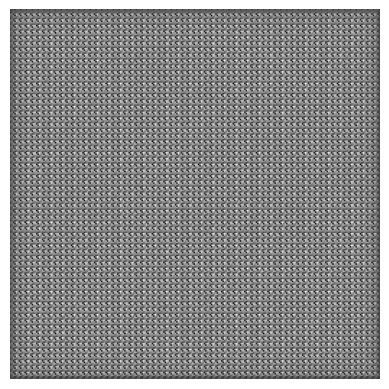

Epoch 15: Critic Loss=41.24000930786133, Generator Loss=-0.029069410637021065
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


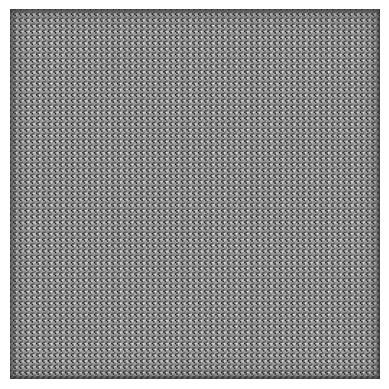

Epoch 20: Critic Loss=40.700374603271484, Generator Loss=-0.12828326225280762
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


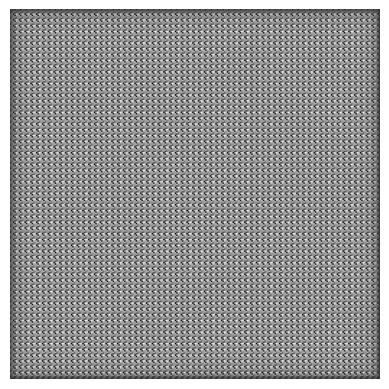

Epoch 25: Critic Loss=40.18218994140625, Generator Loss=-0.44945228099823
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


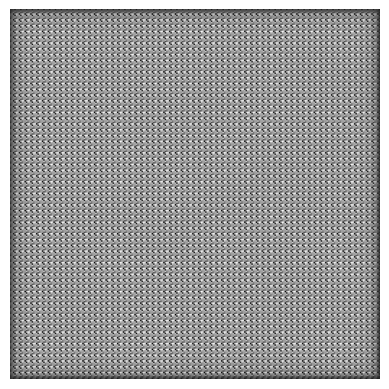

Epoch 30: Critic Loss=40.120391845703125, Generator Loss=-1.2399141788482666
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


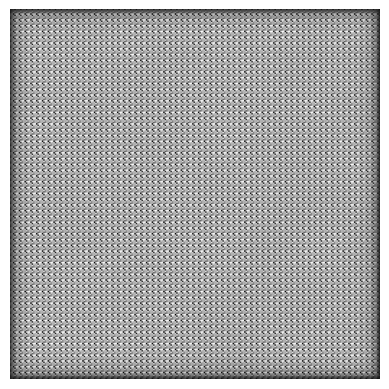

Epoch 35: Critic Loss=40.456233978271484, Generator Loss=-2.4728808403015137
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


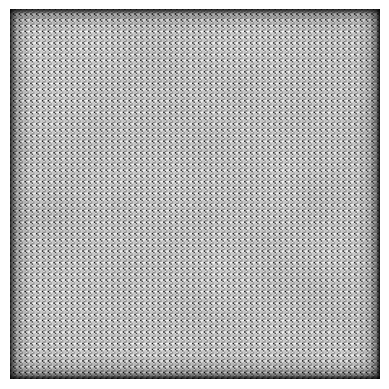

Epoch 40: Critic Loss=41.188724517822266, Generator Loss=-3.5207390785217285
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


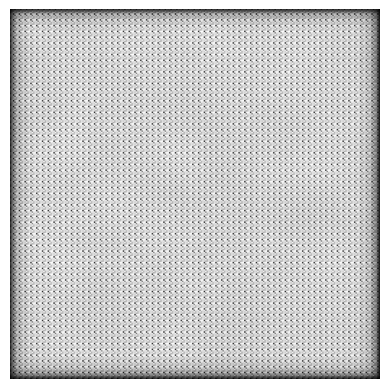

Epoch 45: Critic Loss=41.02079772949219, Generator Loss=-3.939112424850464
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


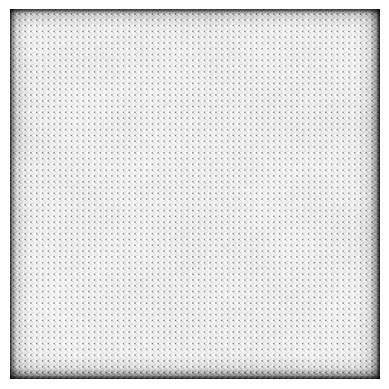

Epoch 50: Critic Loss=41.14580535888672, Generator Loss=-3.7921223640441895
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


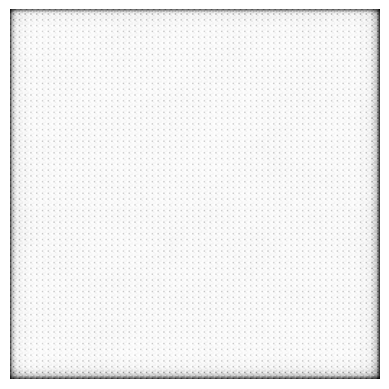

Epoch 55: Critic Loss=40.940818786621094, Generator Loss=-3.4268758296966553
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


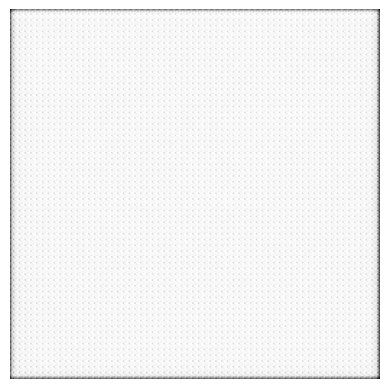

Epoch 60: Critic Loss=40.324180603027344, Generator Loss=-2.980998992919922
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


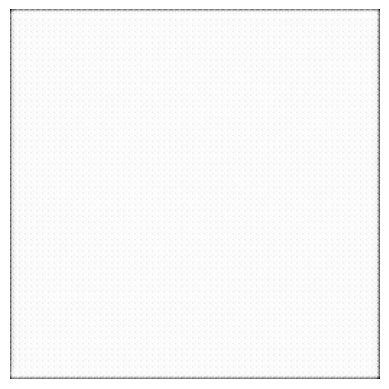

Epoch 65: Critic Loss=39.88924789428711, Generator Loss=-2.556779384613037
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


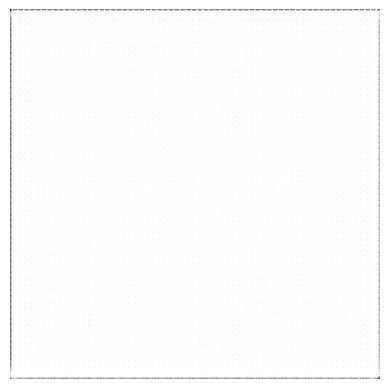

Epoch 70: Critic Loss=39.46967315673828, Generator Loss=-2.1790013313293457
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


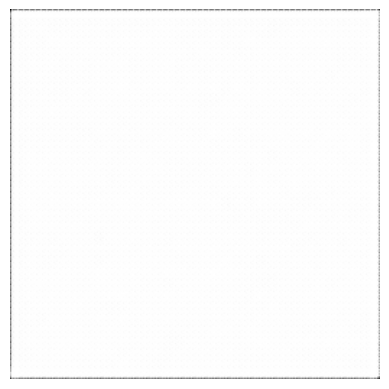

Epoch 75: Critic Loss=38.962364196777344, Generator Loss=-1.8009238243103027
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


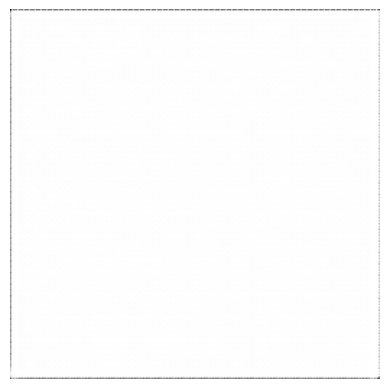

Epoch 80: Critic Loss=38.51921844482422, Generator Loss=-1.458329439163208
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


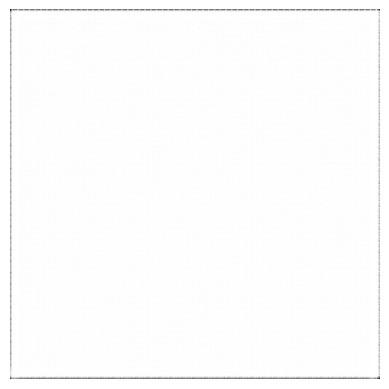

Epoch 85: Critic Loss=38.077796936035156, Generator Loss=-1.1609716415405273
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


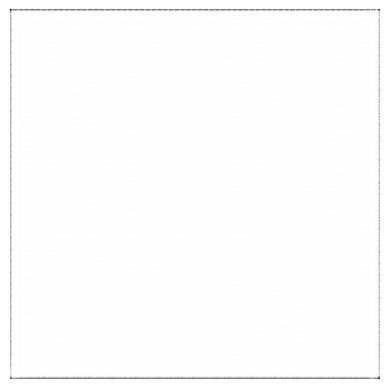

Epoch 90: Critic Loss=37.6597900390625, Generator Loss=-0.8407971262931824
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


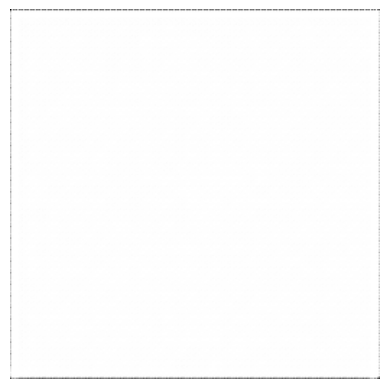

Epoch 95: Critic Loss=37.09286117553711, Generator Loss=-0.5304102897644043
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


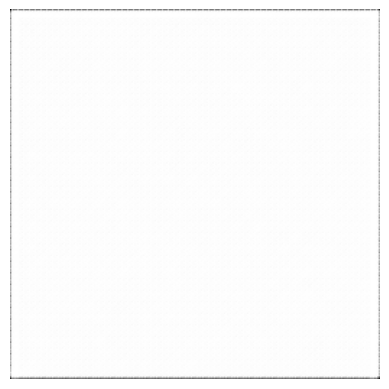

Epoch 100: Critic Loss=36.79059600830078, Generator Loss=-0.16849172115325928
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


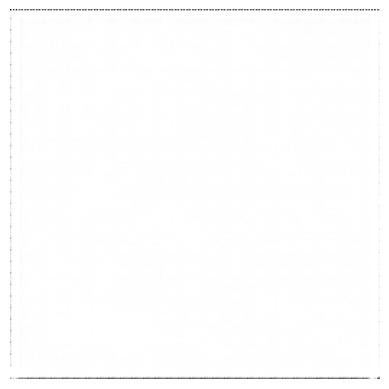

Epoch 105: Critic Loss=36.24653244018555, Generator Loss=0.19395671784877777
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


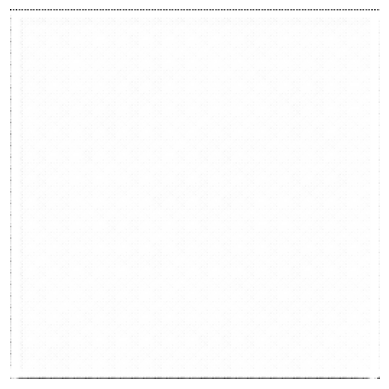

Epoch 110: Critic Loss=35.56622314453125, Generator Loss=0.5034101009368896
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


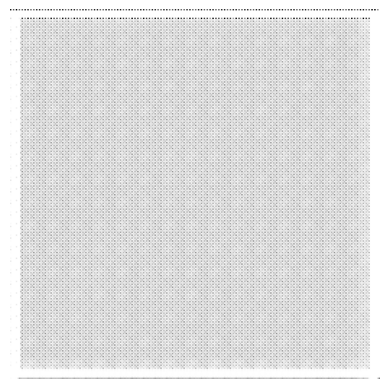

Epoch 115: Critic Loss=35.3935546875, Generator Loss=0.4943034052848816
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


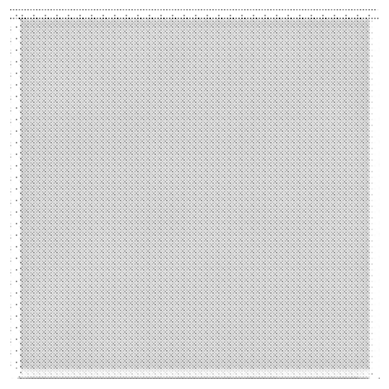

Epoch 120: Critic Loss=35.03779220581055, Generator Loss=0.3566829562187195
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


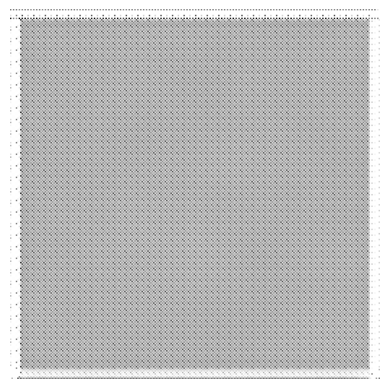

Epoch 125: Critic Loss=34.70962142944336, Generator Loss=0.1213422417640686
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


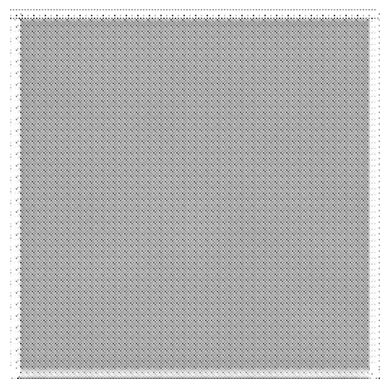

Epoch 130: Critic Loss=34.16688919067383, Generator Loss=-0.0995960384607315
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


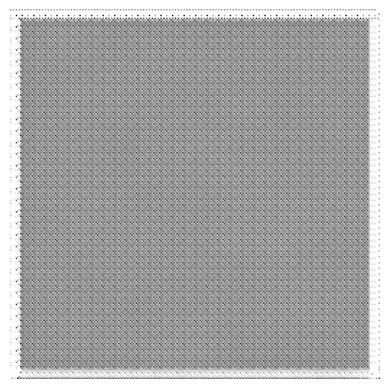

Epoch 135: Critic Loss=34.17177200317383, Generator Loss=-0.3422161936759949
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


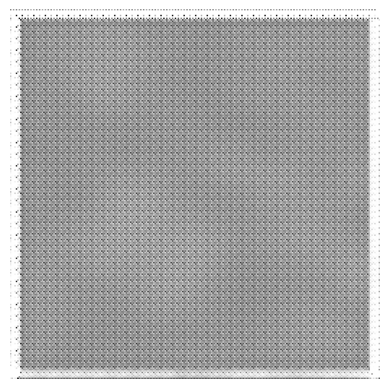

Epoch 140: Critic Loss=33.903018951416016, Generator Loss=-0.5623024106025696
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


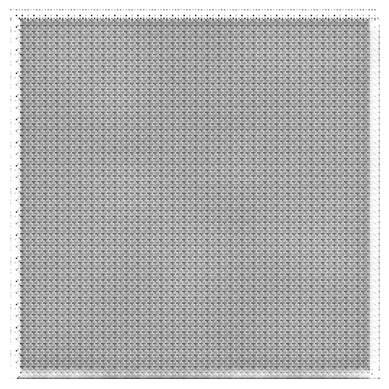

Epoch 145: Critic Loss=33.652549743652344, Generator Loss=-0.7186880111694336
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


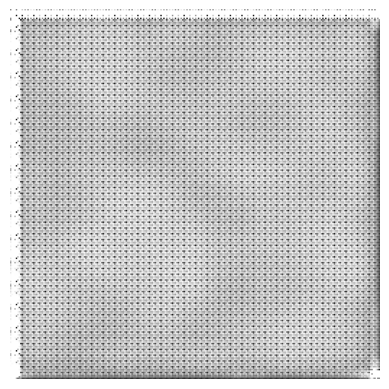

Epoch 150: Critic Loss=33.61256790161133, Generator Loss=-0.7318246364593506
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


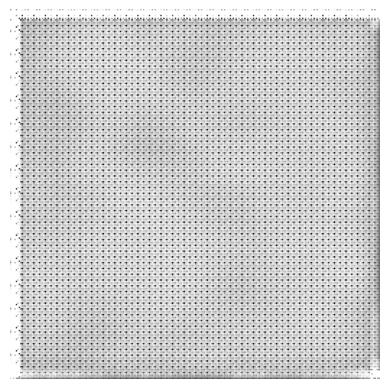

Epoch 155: Critic Loss=33.18993377685547, Generator Loss=-0.580280065536499
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


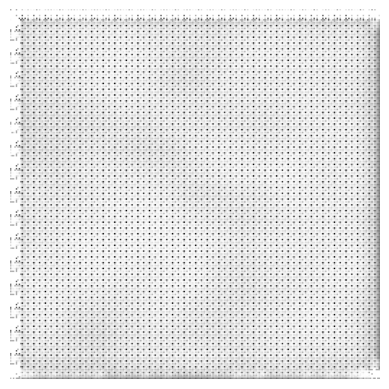

Epoch 160: Critic Loss=32.55928039550781, Generator Loss=-0.37526559829711914
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


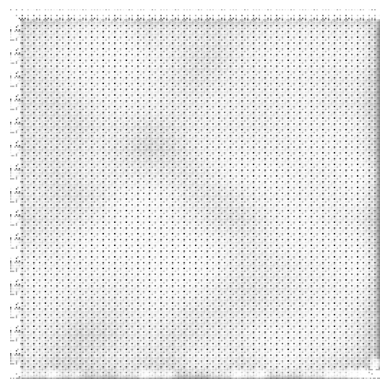

Epoch 165: Critic Loss=32.126468658447266, Generator Loss=-0.21991777420043945
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


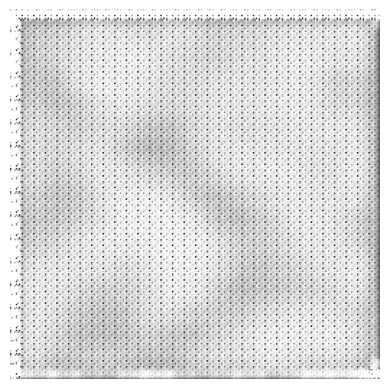

Epoch 170: Critic Loss=31.448259353637695, Generator Loss=-0.18067985773086548
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


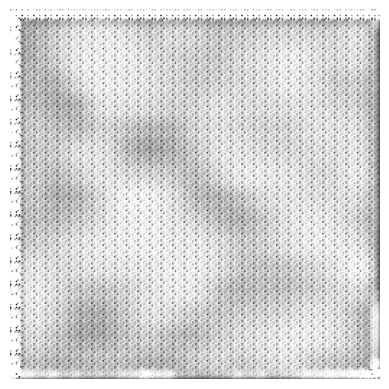

Epoch 175: Critic Loss=31.273353576660156, Generator Loss=-0.18774840235710144
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


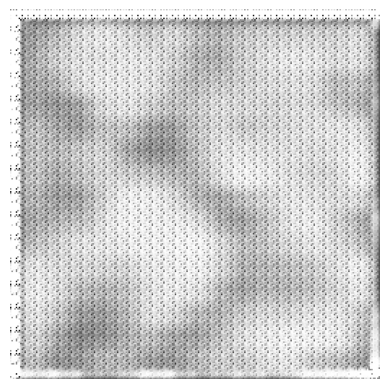

Epoch 180: Critic Loss=30.894800186157227, Generator Loss=-0.23149597644805908
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


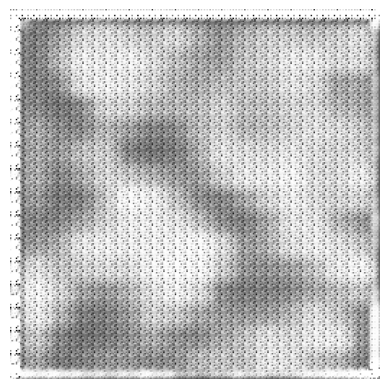

Epoch 185: Critic Loss=30.33460807800293, Generator Loss=-0.2846912443637848
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


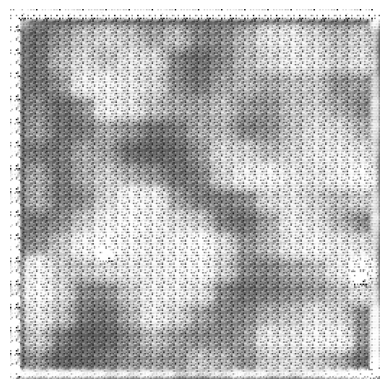

Epoch 190: Critic Loss=29.851022720336914, Generator Loss=-0.41271501779556274
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


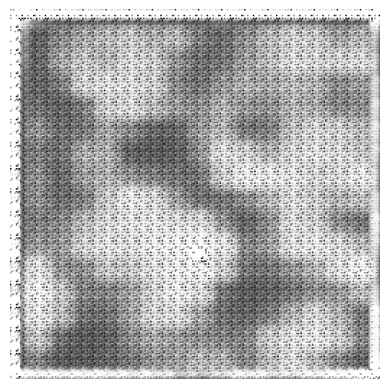

Epoch 195: Critic Loss=29.249975204467773, Generator Loss=-0.4991895854473114
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


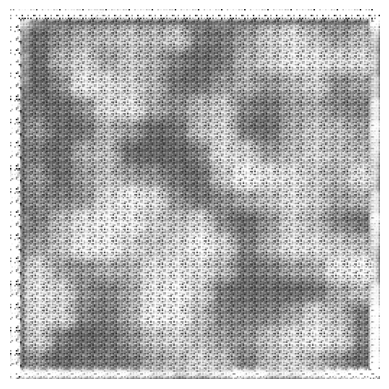

Epoch 200: Critic Loss=28.650327682495117, Generator Loss=-0.5662599205970764
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


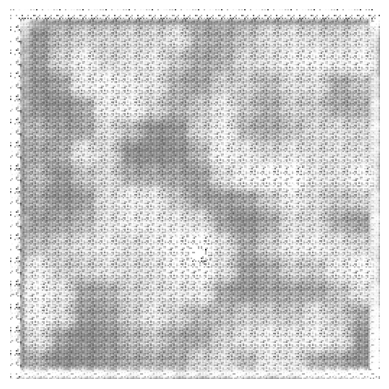

Epoch 205: Critic Loss=27.91326332092285, Generator Loss=-0.6086996793746948
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


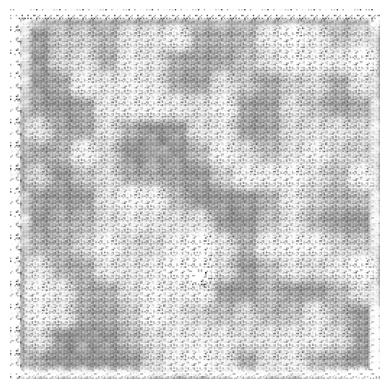

Epoch 210: Critic Loss=27.424306869506836, Generator Loss=-0.6695724725723267
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


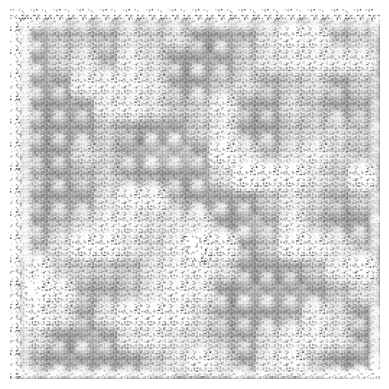

Epoch 215: Critic Loss=26.876237869262695, Generator Loss=-0.7623082995414734
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


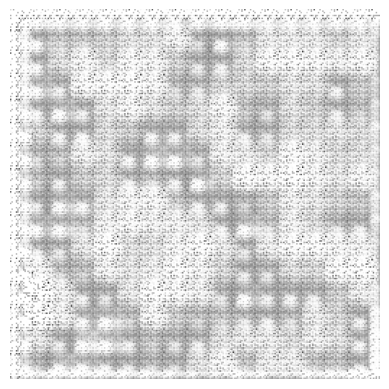

Epoch 220: Critic Loss=26.481239318847656, Generator Loss=-0.8221184611320496
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


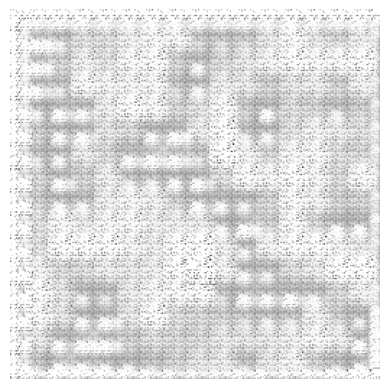

Epoch 225: Critic Loss=26.22602081298828, Generator Loss=-0.8598843216896057
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


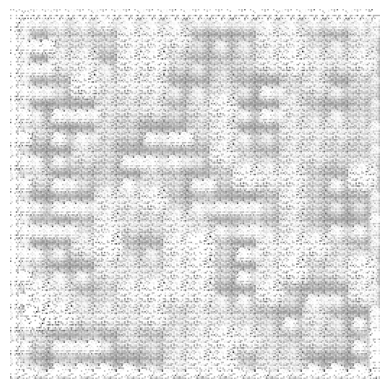

Epoch 230: Critic Loss=25.79013442993164, Generator Loss=-0.9575450420379639
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


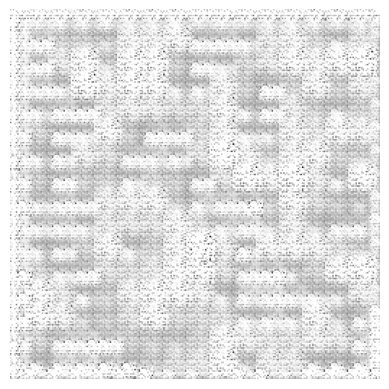

Epoch 235: Critic Loss=25.76828384399414, Generator Loss=-1.0317046642303467
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


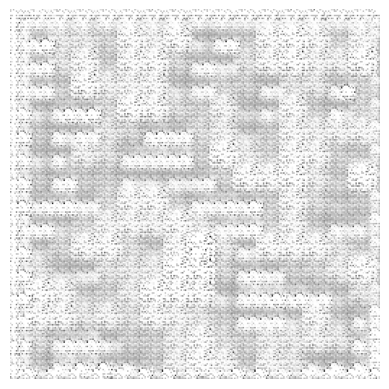

Epoch 240: Critic Loss=25.26952362060547, Generator Loss=-1.1212868690490723
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


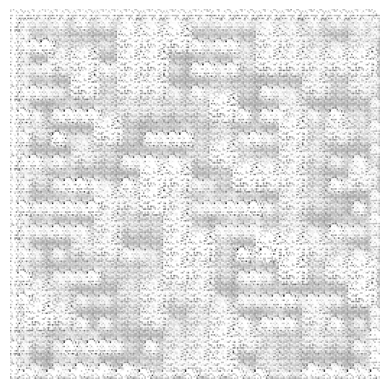

Epoch 245: Critic Loss=25.099451065063477, Generator Loss=-1.1622164249420166
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


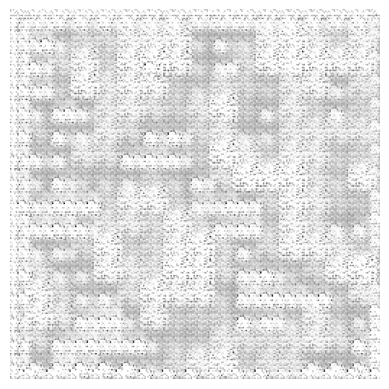

Epoch 250: Critic Loss=24.6586856842041, Generator Loss=-1.2180101871490479
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


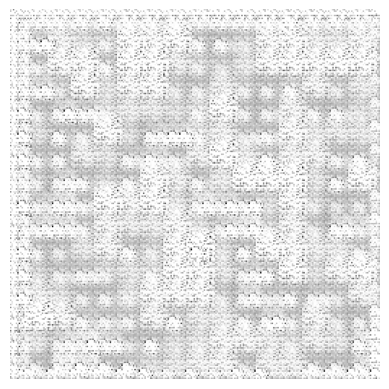

Epoch 255: Critic Loss=24.47279167175293, Generator Loss=-1.3003896474838257
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


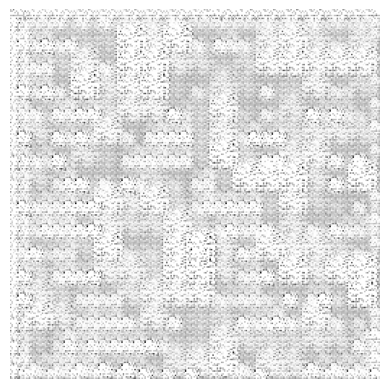

Epoch 260: Critic Loss=24.53653335571289, Generator Loss=-1.354534387588501
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


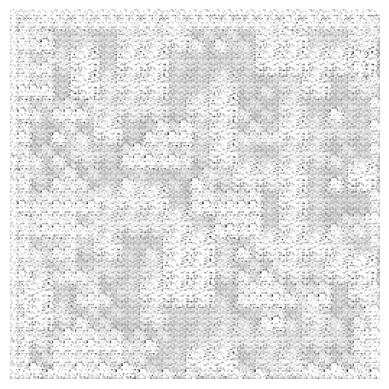

Epoch 265: Critic Loss=24.273719787597656, Generator Loss=-1.4663708209991455
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


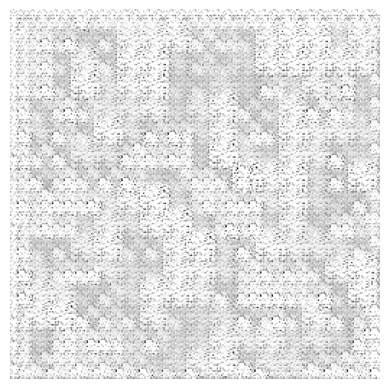

Epoch 270: Critic Loss=24.020793914794922, Generator Loss=-1.4442644119262695
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


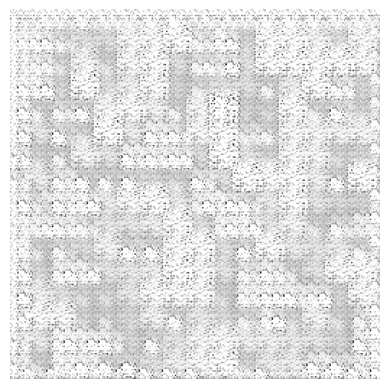

Epoch 275: Critic Loss=24.02105712890625, Generator Loss=-1.668389916419983
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


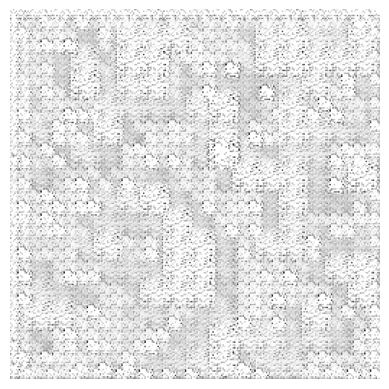

Epoch 280: Critic Loss=23.83932113647461, Generator Loss=-1.7167088985443115
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


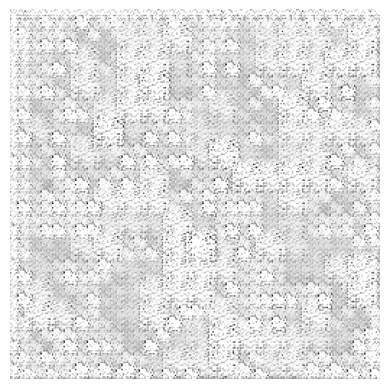

Epoch 285: Critic Loss=23.874462127685547, Generator Loss=-1.9078032970428467
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


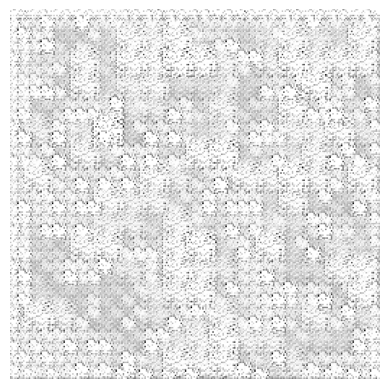

Epoch 290: Critic Loss=24.01732635498047, Generator Loss=-2.0813207626342773
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


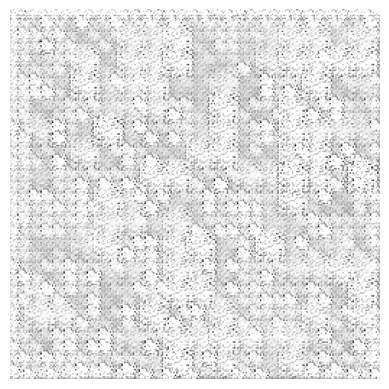

Epoch 295: Critic Loss=23.98868751525879, Generator Loss=-2.336777448654175
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


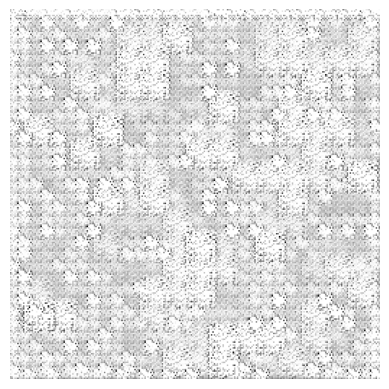

Epoch 300: Critic Loss=24.334266662597656, Generator Loss=-2.535841464996338
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


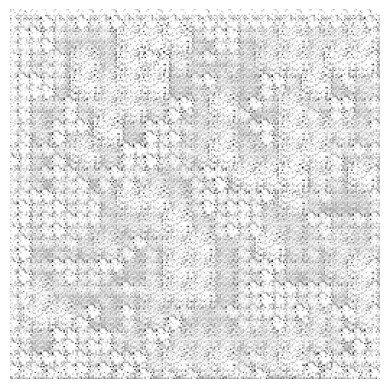

Epoch 305: Critic Loss=24.34404754638672, Generator Loss=-2.64663028717041
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


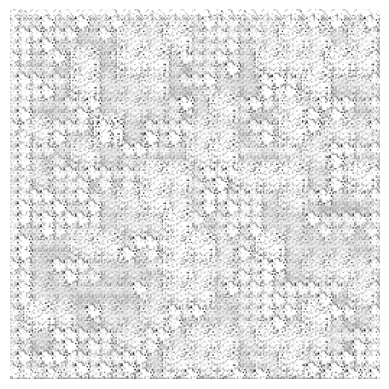

Epoch 310: Critic Loss=24.300153732299805, Generator Loss=-2.832711935043335
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


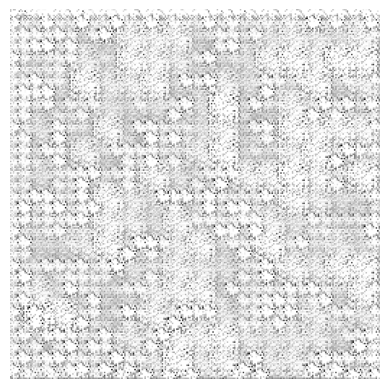

Epoch 315: Critic Loss=24.5228328704834, Generator Loss=-3.200092315673828
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


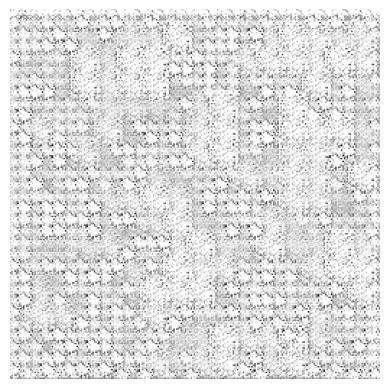

Epoch 320: Critic Loss=25.056751251220703, Generator Loss=-3.2992944717407227
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


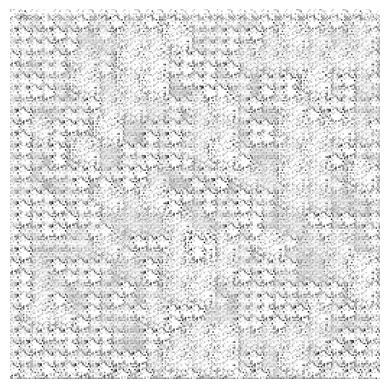

Epoch 325: Critic Loss=24.613126754760742, Generator Loss=-3.544318199157715
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


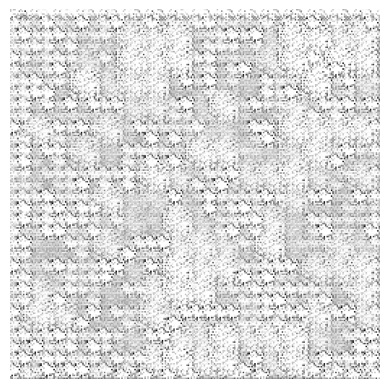

Epoch 330: Critic Loss=24.85079574584961, Generator Loss=-3.5951340198516846
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


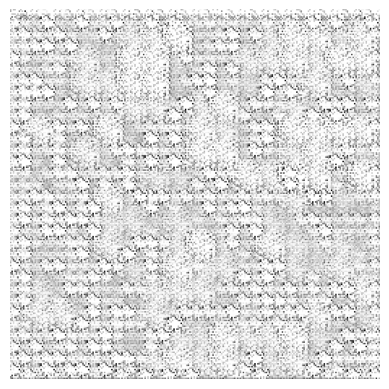

Epoch 335: Critic Loss=24.835582733154297, Generator Loss=-3.593050718307495
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


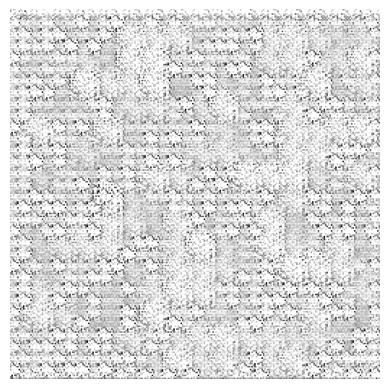

Epoch 340: Critic Loss=24.963003158569336, Generator Loss=-3.8644092082977295
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


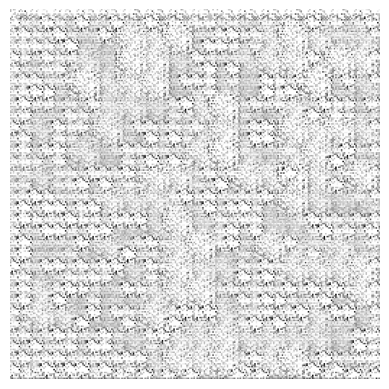

Epoch 345: Critic Loss=24.909465789794922, Generator Loss=-3.8907546997070312
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


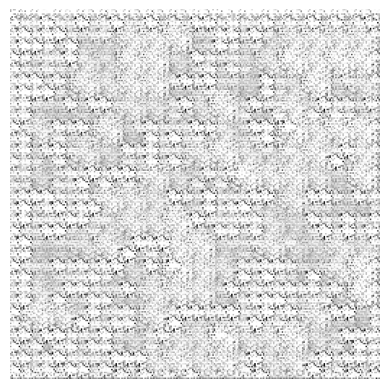

Epoch 350: Critic Loss=25.128650665283203, Generator Loss=-4.082183837890625
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


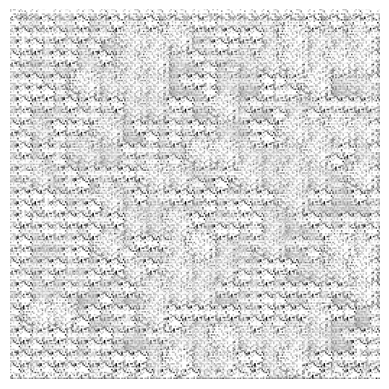

Epoch 355: Critic Loss=25.010108947753906, Generator Loss=-4.173510551452637
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


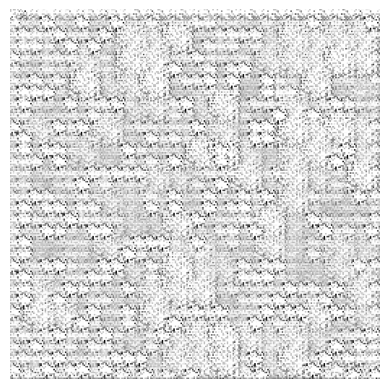

Epoch 360: Critic Loss=24.850727081298828, Generator Loss=-4.2588300704956055
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


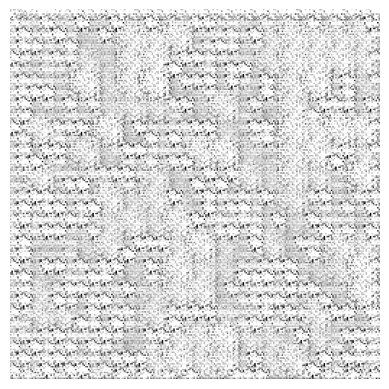

Epoch 365: Critic Loss=24.888357162475586, Generator Loss=-4.006082057952881
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


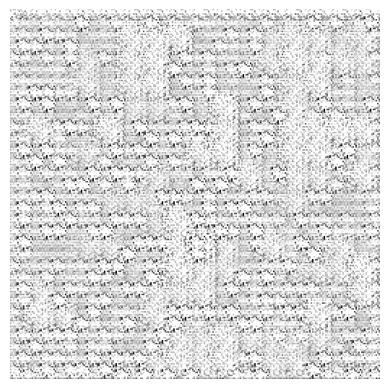

Epoch 370: Critic Loss=24.534849166870117, Generator Loss=-4.0812578201293945
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


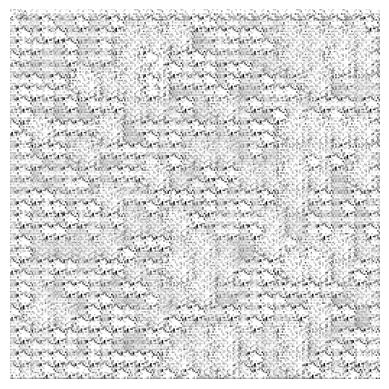

Epoch 375: Critic Loss=24.439191818237305, Generator Loss=-4.108675479888916
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


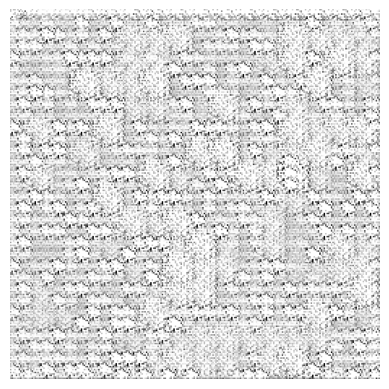

Epoch 380: Critic Loss=24.583385467529297, Generator Loss=-4.131927967071533
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


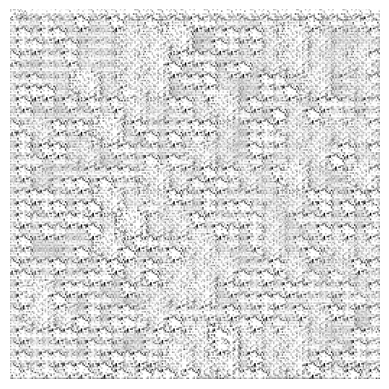

Epoch 385: Critic Loss=24.450885772705078, Generator Loss=-4.17158317565918
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


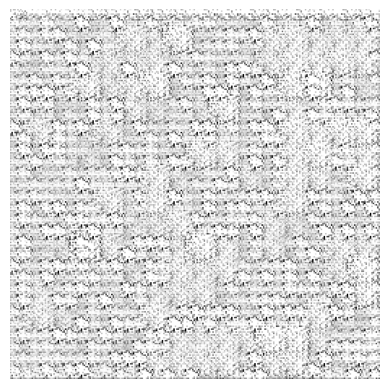

Epoch 390: Critic Loss=24.424726486206055, Generator Loss=-4.23897123336792
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


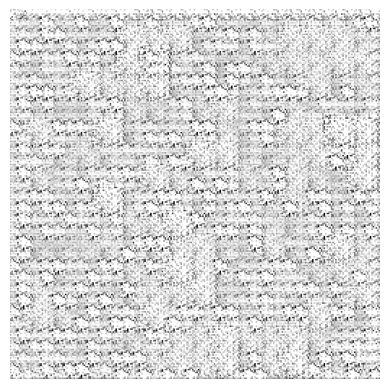

Epoch 395: Critic Loss=24.134727478027344, Generator Loss=-4.034116744995117
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


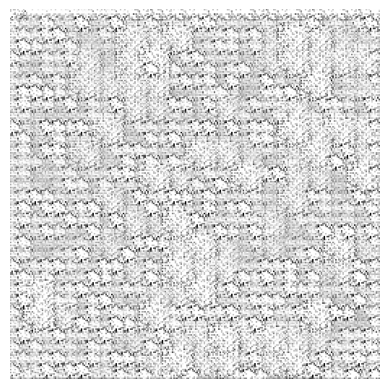

Epoch 400: Critic Loss=24.50035285949707, Generator Loss=-4.3104705810546875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


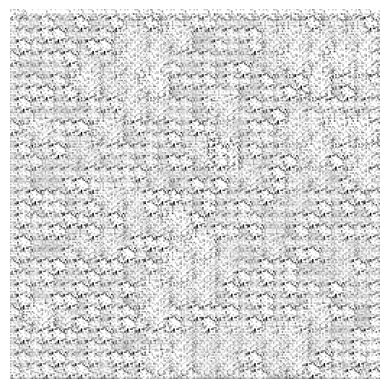

Epoch 405: Critic Loss=24.350194931030273, Generator Loss=-4.341064453125
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


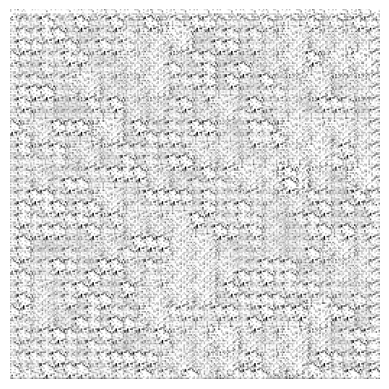

Epoch 410: Critic Loss=23.75588035583496, Generator Loss=-3.985145092010498
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


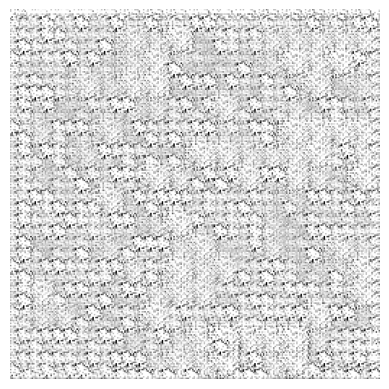

Epoch 415: Critic Loss=24.184497833251953, Generator Loss=-4.380093574523926
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


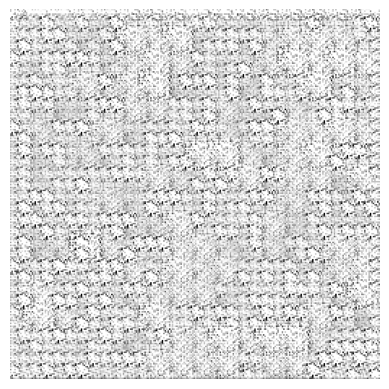

Epoch 420: Critic Loss=23.835710525512695, Generator Loss=-4.422370910644531
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


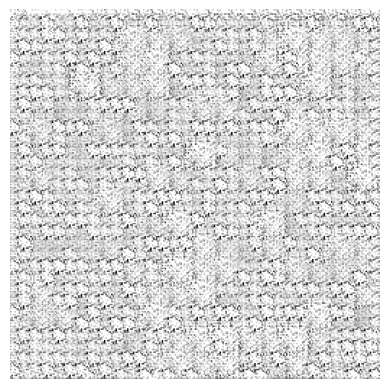

Epoch 425: Critic Loss=24.06777572631836, Generator Loss=-4.480224609375
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


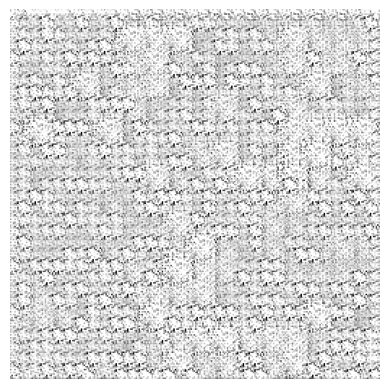

Epoch 430: Critic Loss=24.15715789794922, Generator Loss=-4.664248943328857
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


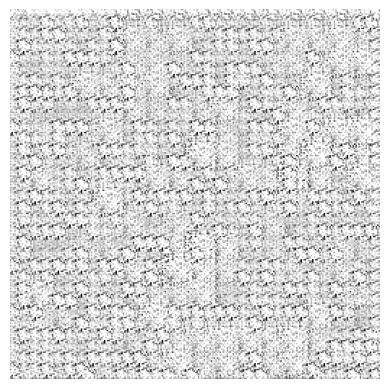

Epoch 435: Critic Loss=23.868940353393555, Generator Loss=-4.542446136474609
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


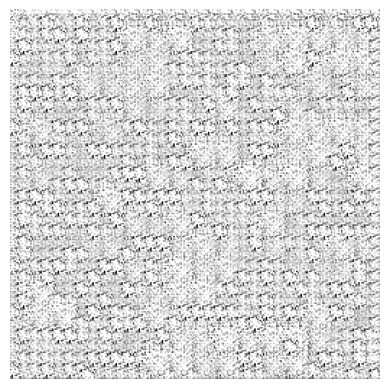

Epoch 440: Critic Loss=24.239524841308594, Generator Loss=-4.697807312011719
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


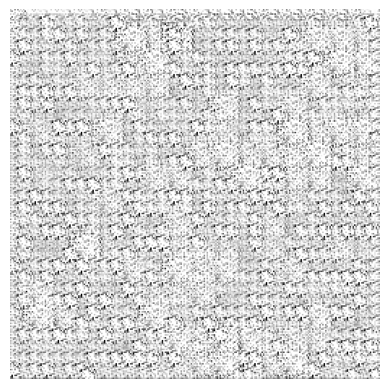

Epoch 445: Critic Loss=23.932628631591797, Generator Loss=-4.574021816253662
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


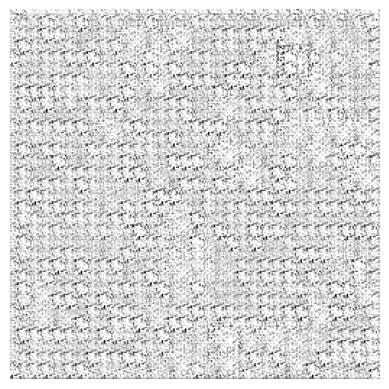

Epoch 450: Critic Loss=23.672016143798828, Generator Loss=-4.334023475646973
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


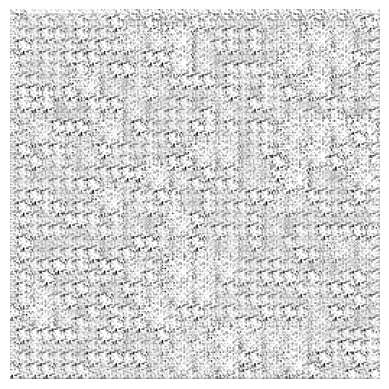

Epoch 455: Critic Loss=23.77096176147461, Generator Loss=-4.620212554931641
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


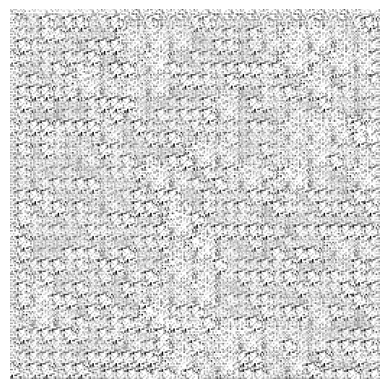

Epoch 460: Critic Loss=23.416507720947266, Generator Loss=-4.362333297729492
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


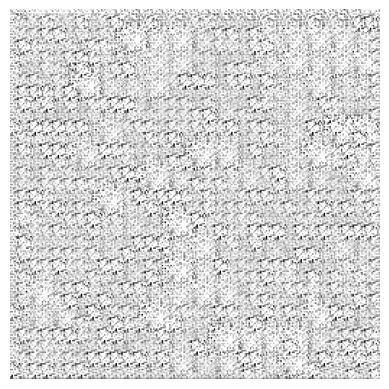

Epoch 465: Critic Loss=23.696006774902344, Generator Loss=-4.5576171875
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


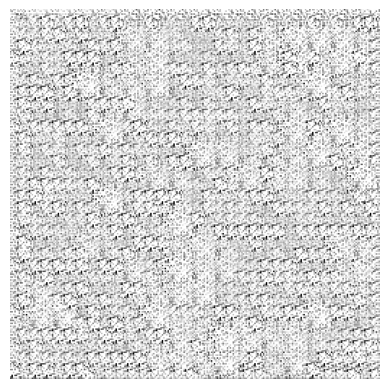

Epoch 470: Critic Loss=23.865739822387695, Generator Loss=-4.781195640563965
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


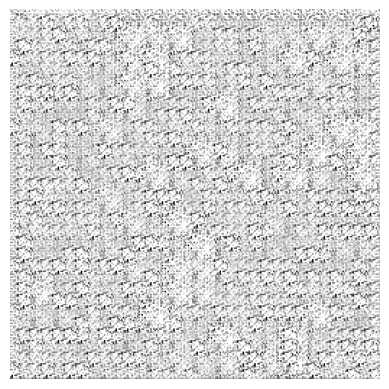

Epoch 475: Critic Loss=23.107349395751953, Generator Loss=-4.330392837524414
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


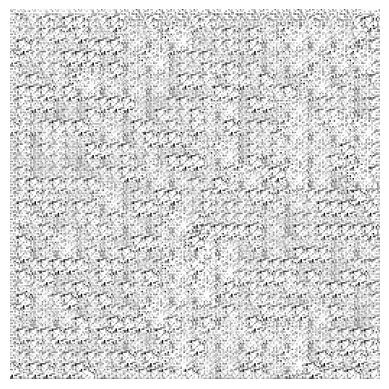

Epoch 480: Critic Loss=23.344661712646484, Generator Loss=-4.575172424316406
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


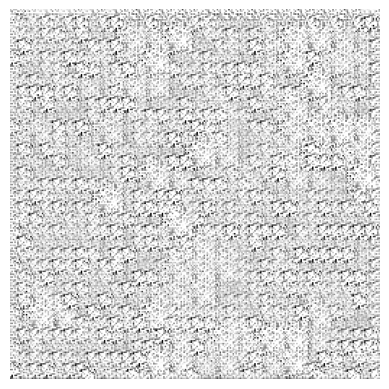

Epoch 485: Critic Loss=23.272666931152344, Generator Loss=-4.528830528259277
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


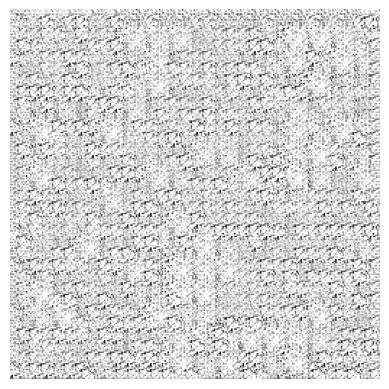

Epoch 490: Critic Loss=22.475011825561523, Generator Loss=-3.9764842987060547
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


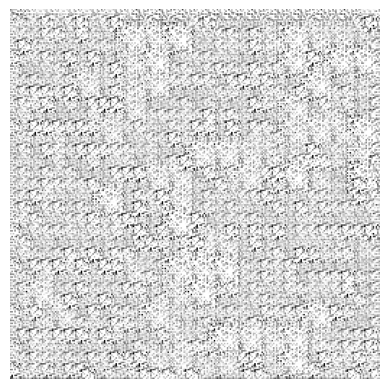

Epoch 495: Critic Loss=22.728193283081055, Generator Loss=-4.399380683898926
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


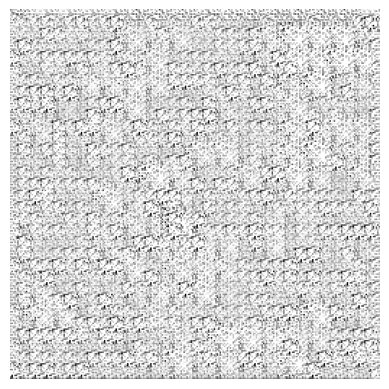

Epoch 500: Critic Loss=22.714496612548828, Generator Loss=-4.597525596618652
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


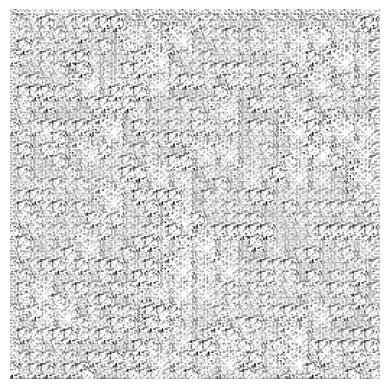

Epoch 505: Critic Loss=22.451223373413086, Generator Loss=-4.582952499389648
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


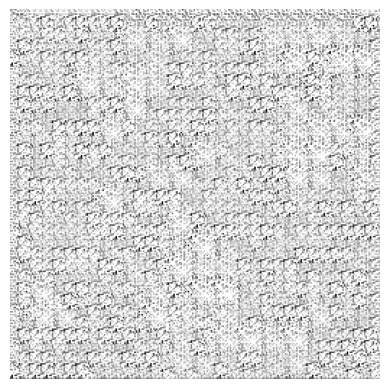

Epoch 510: Critic Loss=22.439538955688477, Generator Loss=-4.634758949279785
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


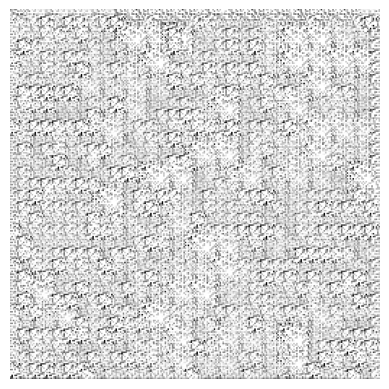

Epoch 515: Critic Loss=22.39737319946289, Generator Loss=-4.571459770202637
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


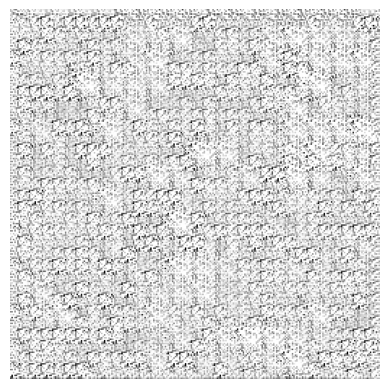

Epoch 520: Critic Loss=22.129009246826172, Generator Loss=-4.730637550354004
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


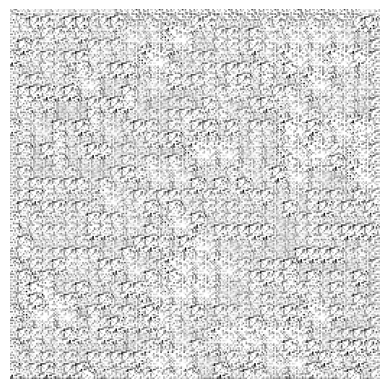

Epoch 525: Critic Loss=21.839250564575195, Generator Loss=-4.789224147796631
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


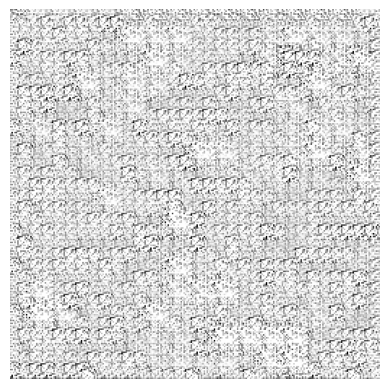

Epoch 530: Critic Loss=21.740442276000977, Generator Loss=-4.695744514465332
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


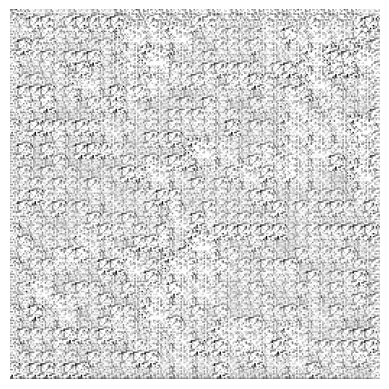

Epoch 535: Critic Loss=21.695417404174805, Generator Loss=-4.9577155113220215
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


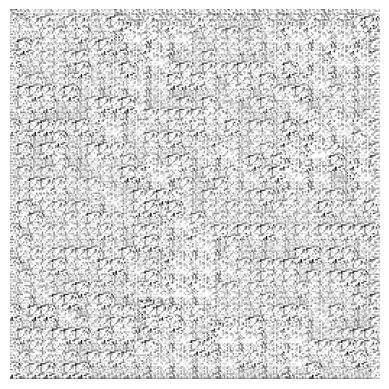

Epoch 540: Critic Loss=21.836231231689453, Generator Loss=-5.046748161315918
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


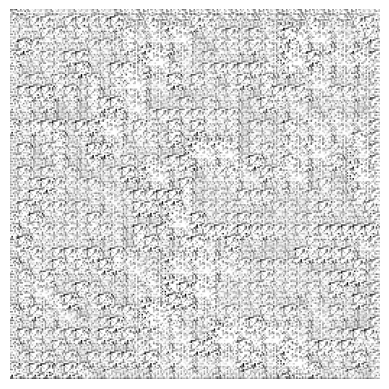

Epoch 545: Critic Loss=21.57744598388672, Generator Loss=-4.998461723327637
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


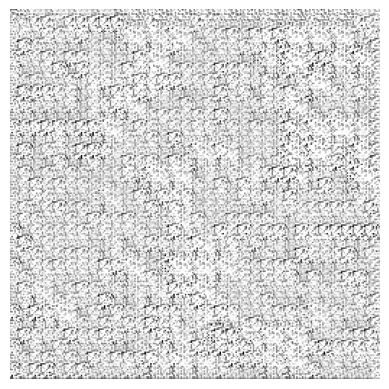

Epoch 550: Critic Loss=21.196205139160156, Generator Loss=-5.018611431121826
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


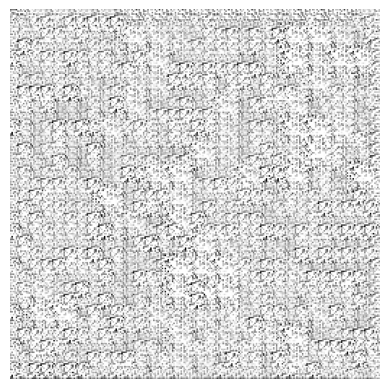

Epoch 555: Critic Loss=21.565624237060547, Generator Loss=-5.342888355255127
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


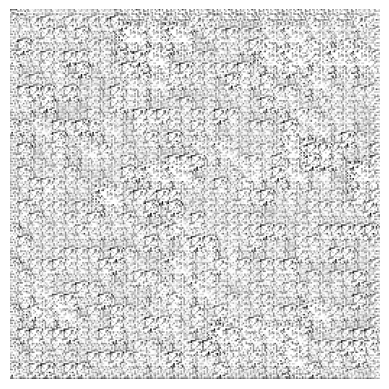

Epoch 560: Critic Loss=21.513559341430664, Generator Loss=-5.288900375366211
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


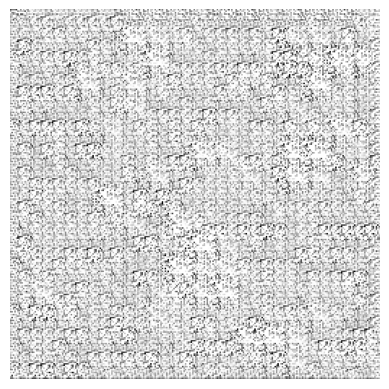

Epoch 565: Critic Loss=21.005903244018555, Generator Loss=-5.183398723602295
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


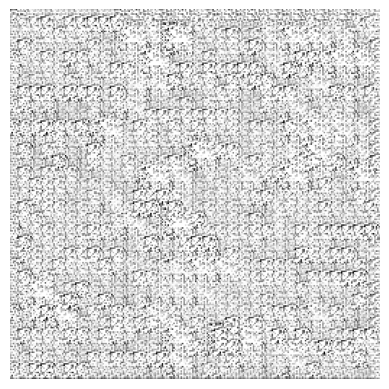

Epoch 570: Critic Loss=20.772357940673828, Generator Loss=-5.201528072357178
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


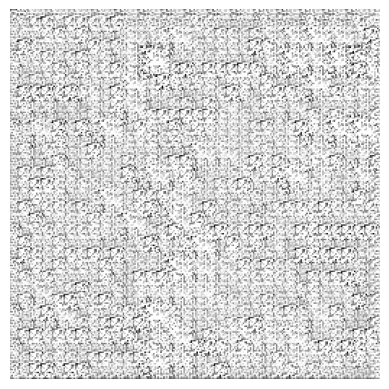

Epoch 575: Critic Loss=20.752197265625, Generator Loss=-5.184093475341797
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


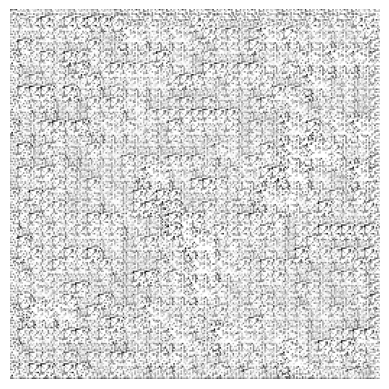

Epoch 580: Critic Loss=21.154863357543945, Generator Loss=-5.713235855102539
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


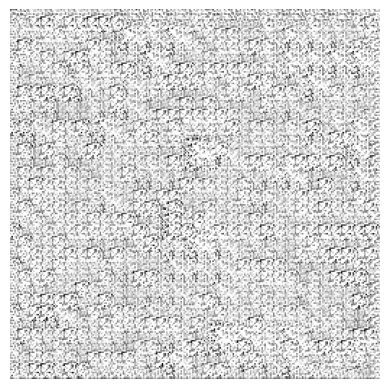

Epoch 585: Critic Loss=20.989389419555664, Generator Loss=-5.660564422607422
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


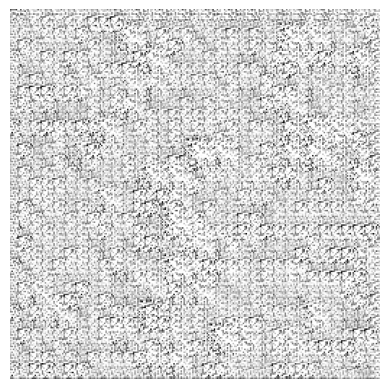

Epoch 590: Critic Loss=20.86766815185547, Generator Loss=-5.723779678344727
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


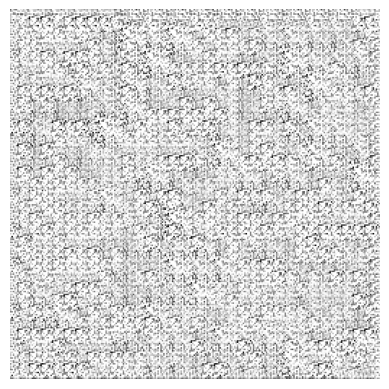

Epoch 595: Critic Loss=20.2535400390625, Generator Loss=-5.296542167663574
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


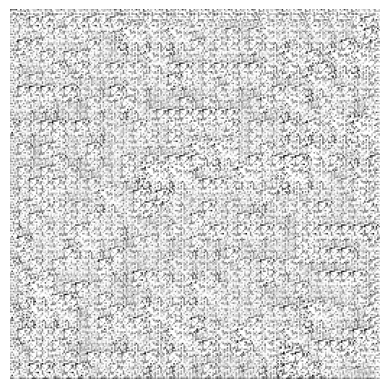

Epoch 600: Critic Loss=20.710216522216797, Generator Loss=-6.070839881896973
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


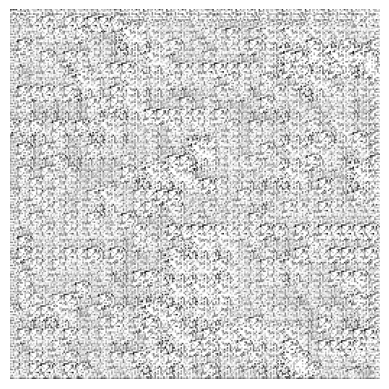

Epoch 605: Critic Loss=20.33163833618164, Generator Loss=-5.621947288513184
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


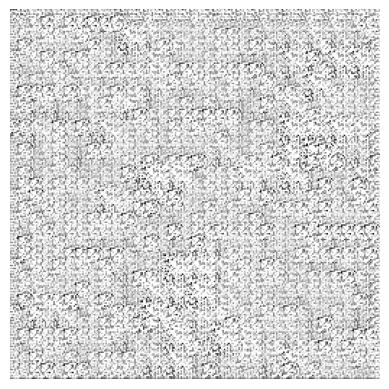

Epoch 610: Critic Loss=20.240297317504883, Generator Loss=-5.722578048706055
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


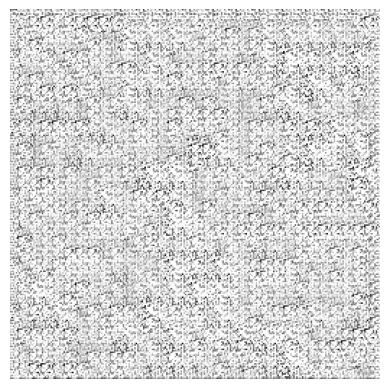

Epoch 615: Critic Loss=20.54495620727539, Generator Loss=-6.308610439300537
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


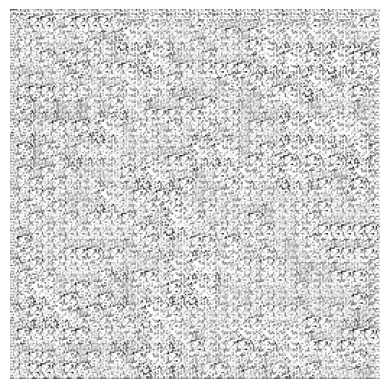

Epoch 620: Critic Loss=20.304372787475586, Generator Loss=-6.0328497886657715
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


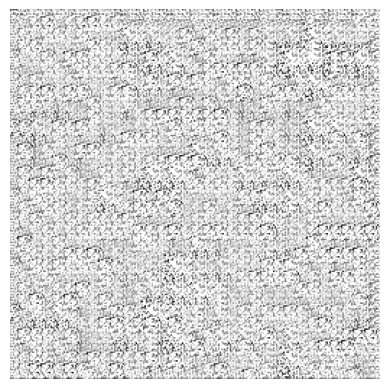

Epoch 625: Critic Loss=20.212177276611328, Generator Loss=-6.027956962585449
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


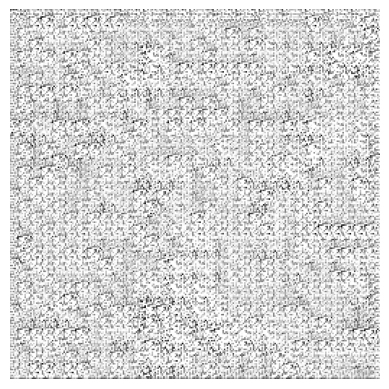

Epoch 630: Critic Loss=20.556137084960938, Generator Loss=-6.6901469230651855
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


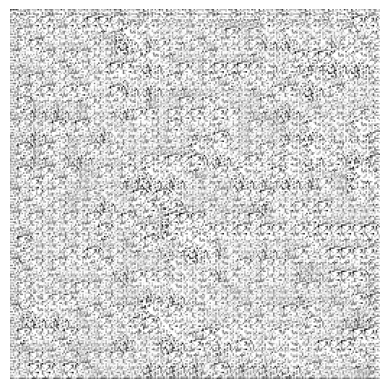

Epoch 635: Critic Loss=19.846649169921875, Generator Loss=-6.296595573425293
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


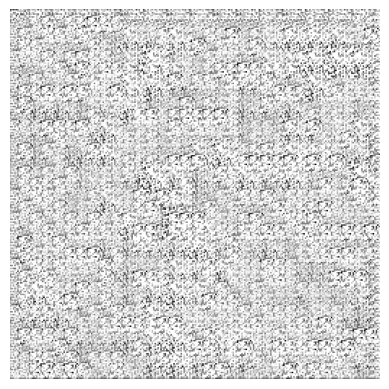

Epoch 640: Critic Loss=20.27351188659668, Generator Loss=-6.725978374481201
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


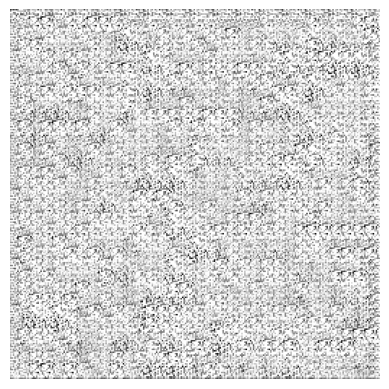

Epoch 645: Critic Loss=20.191390991210938, Generator Loss=-6.788111686706543
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


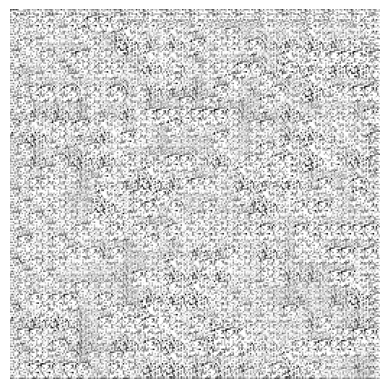

In [ ]:
dataset_path = '/content/non-faulty/'

datagen = ImageDataGenerator(rescale=1./255)

data = datagen.flow_from_directory(
    dataset_path,
    target_size=(256, 256),
    batch_size=32,
    class_mode=None,
    shuffle=True,
    color_mode='grayscale'
)

os.makedirs("generated_images", exist_ok=True)

def generate_and_save_images(generator, epoch, latent_dim=100, num_examples=1):
    noise = np.random.randn(num_examples, latent_dim)
    generated_images = generator.predict(noise)

    for i in range(num_examples):
        img = (generated_images[i] + 1) / 2  # scale from [-1, 1] to [0, 1]
        plt.imshow(img.squeeze(), cmap='gray')
        plt.axis('off')
        plt.savefig(f'generated_images/epoch_{epoch}.png', bbox_inches='tight', pad_inches=0)
        plt.show()

def gradient_penalty(real_images, fake_images):
    batch_size = real_images.shape[0]
    alpha = tf.random.uniform([batch_size, 1, 1, 1], 0.0, 1.0)
    interpolated = alpha * real_images + (1 - alpha) * fake_images
    with tf.GradientTape() as tape:
        tape.watch(interpolated)
        pred = critic(interpolated, training=True)
    grads = tape.gradient(pred, [interpolated])[0]
    norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]))
    return tf.reduce_mean((norm - 1.0) ** 2)

@tf.function
def train_step(real_images):
    batch_size = real_images.shape[0]
    real_images = tf.convert_to_tensor(real_images, dtype=tf.float32)

    for _ in range(critic_updates):
        noise = tf.random.normal([batch_size, latent_dim])
        fake_images = generator(noise, training=True)

        with tf.GradientTape() as tape:
            real_output = critic(real_images, training=True)
            fake_output = critic(fake_images, training=True)
            gp = gradient_penalty(real_images, fake_images)

            critic_loss = -tf.reduce_mean(real_output) + tf.reduce_mean(fake_output) + lambda_gp * gp

        gradients = tape.gradient(critic_loss, critic.trainable_variables)
        critic_optimizer.apply_gradients(zip(gradients, critic.trainable_variables))

    noise = tf.random.normal([batch_size, latent_dim])
    with tf.GradientTape() as tape:
        fake_images = generator(noise, training=True)
        fake_output = critic(fake_images, training=True)
        generator_loss = -tf.reduce_mean(fake_output)

    gradients = tape.gradient(generator_loss, generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients, generator.trainable_variables))

    return critic_loss, generator_loss

def train_wgan_gp(epochs=2500, batch_size=32, display_interval=5):
    losses = {'critic_loss': [], 'generator_loss': []}

    for epoch in range(epochs):
        real_images = next(data)
        real_images = real_images.astype('float32')

        c_loss, g_loss = train_step(real_images)

        losses['critic_loss'].append(c_loss)
        losses['generator_loss'].append(g_loss)

        if epoch % display_interval == 0:
            print(f'Epoch {epoch}: Critic Loss={c_loss}, Generator Loss={g_loss}')
            generate_and_save_images(generator, epoch, latent_dim)

    return losses

def plot_losses(losses):
    plt.plot(losses['critic_loss'], label='Critic Loss')
    plt.plot(losses['generator_loss'], label='Generator Loss')
    plt.legend()
    plt.show()

losses = train_wgan_gp()
plot_losses(losses)
